<a href="https://colab.research.google.com/github/RflHrq/Trabalho-SIN492/blob/main/Projetosin492.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Rede Neural MLP

In [95]:
#Importa as bibliotecas
import numpy as np
import pandas as pd
import scipy.stats as stats
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import RandomizedSearchCV
from sklearn.preprocessing import StandardScaler


In [ ]:
#Carregamento do Dataset
df = pd.read_parquet('dataset_SIN492.parquet')

In [ ]:
X = df.drop(['target'], axis=1)
y = df['target']


In [96]:
#Analise Exploratoria
profile = ProfileReport(X, title='Relatorio Analise Exploratoria', explorative=True)
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#Divisão de treino e teste
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [ ]:
#Normalização dos dados
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [105]:
# Treinamento do modelo MLP no conjunto reduzido de características
mlp = MLPClassifier(hidden_layer_sizes=(1000, 50), max_iter=600, random_state=42, learning_rate='constant', learning_rate_init=0.0005,
                   activation='relu', solver='adam', alpha=0.0001, batch_size='auto')
mlp.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (600) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier(hidden_layer_sizes=(1000, 50), learning_rate_init=0.0005,
              max_iter=600, random_state=42)

In [106]:
y_pred = mlp.predict(X_test)

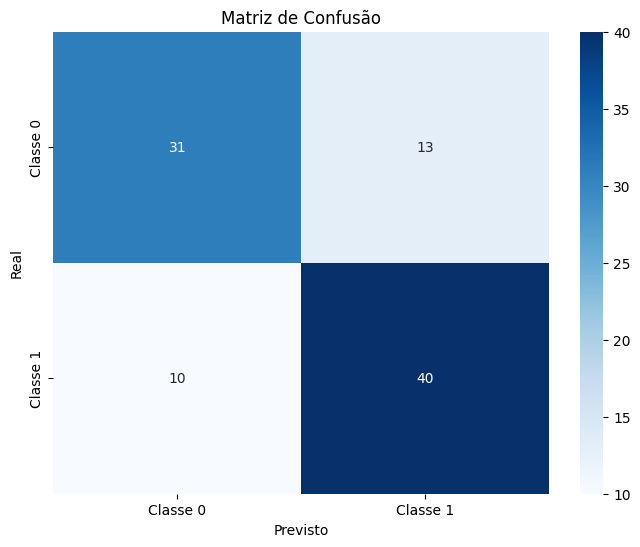

Acurácia: 0.7553191489361702
Relatório de Classificação:
               precision    recall  f1-score   support

           0       0.76      0.70      0.73        44
           1       0.75      0.80      0.78        50

    accuracy                           0.76        94
   macro avg       0.76      0.75      0.75        94
weighted avg       0.76      0.76      0.75        94



In [108]:
#Avaliação do modelo
accuracy = accuracy_score(y_test, y_pred)

# Crie uma matriz de confusão
cm = confusion_matrix(y_test, y_pred)

# Visualize a matriz de confusão com seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Classe 0', 'Classe 1'], yticklabels=['Classe 0', 'Classe 1'])
plt.xlabel('Previsto')
plt.ylabel('Real')
plt.title('Matriz de Confusão')
plt.show()

# Crie e imprima um relatório de classificação
print(f'Acurácia: {accuracy}')
report = classification_report(y_test, y_pred)
print("Relatório de Classificação:\n", report)

Classificador Regressão Logística

In [99]:
#Importa as bibliotecas
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

In [100]:
#Ajuste de Parâmetros
reglog = LogisticRegression(penalty='l2', C=0.138, solver='liblinear')
reglog.fit(X_train, y_train)

LogisticRegression(C=0.138, solver='liblinear')

In [109]:
#Predição
y_pred = reglog.predict(X_test)

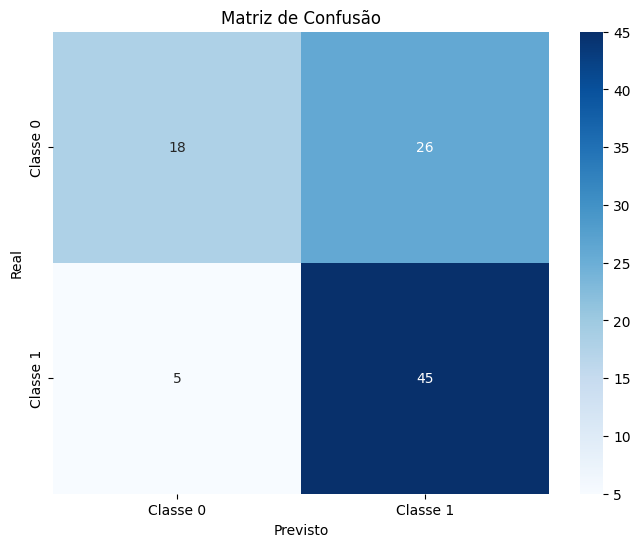

Acurácia: 0.6702127659574468
Relatório de Classificação:
               precision    recall  f1-score   support

           0       0.78      0.41      0.54        44
           1       0.63      0.90      0.74        50

    accuracy                           0.67        94
   macro avg       0.71      0.65      0.64        94
weighted avg       0.70      0.67      0.65        94



In [110]:
#Avaliação do modelo
accuracy = accuracy_score(y_test, y_pred)

# Crie uma matriz de confusão
cm = confusion_matrix(y_test, y_pred)

# Visualize a matriz de confusão com seaborn
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Classe 0', 'Classe 1'], yticklabels=['Classe 0', 'Classe 1'])
plt.xlabel('Previsto')
plt.ylabel('Real')
plt.title('Matriz de Confusão')
plt.show()

# Crie e imprima um relatório de classificação
print(f'Acurácia: {accuracy}')
report = classification_report(y_test, y_pred)
print("Relatório de Classificação:\n", report)